In [ ]:
import numpy as np
import os
import random
import cv2
from tqdm.notebook import tqdm  # for progress bars in notebook
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score



In [3]:
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        if os.path.isdir(file_path) or not file_path.endswith(('.png', '.jpg', '.jpeg')):
            continue
        img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
        if img is not None:
            images.append(img.flatten())
    return np.array(images)


In [4]:
def compute_2dpca(images, k):
    # Compute mean image
    mean_image = np.mean(images, axis=0)
    
    # Compute covariance matrix
    cov_matrix = np.zeros_like(np.outer(mean_image, mean_image))
    for image in tqdm(images, desc='Computing Covariance'):  # tqdm for covariance computation
        diff = image - mean_image
        cov_matrix += np.outer(diff, diff)
    
    # Compute eigenvectors
    eig_vals, eig_vecs = np.linalg.eigh(cov_matrix)
    sorted_indices = np.argsort(-eig_vals)
    eig_vecs = eig_vecs[:, sorted_indices]
    
    # Return top k eigenvectors
    return eig_vecs[:, :k]

In [5]:
def project_2dpca(images, eig_vecs):
    return np.dot(images, eig_vecs)


In [6]:
def generate_pairs(dataset_dir):
    pairs = []
    labels = []
    persons = os.listdir(dataset_dir)
    persons = [person for person in persons if os.path.isdir(os.path.join(dataset_dir, person))]
    
    positive_pairs = []
    negative_pairs = []
    
    for person in persons:
        person_dir = os.path.join(dataset_dir, person)
        images = load_images_from_folder(person_dir)
        
        if len(images) < 2:
            continue  # Skip if there are not enough images to form pairs
        
        # Generate all positive pairs
        for i in range(len(images)):
            for j in range(i + 1, len(images)):
                positive_pairs.append((images[i], images[j]))
                
    # Generate negative pairs
    for person in persons:
        person_dir = os.path.join(dataset_dir, person)
        images = load_images_from_folder(person_dir)
        
        if len(images) < 1:
            continue
        
        other_persons = [p for p in persons if p != person]
        for img in images:
            while True:
                other_person = random.choice(other_persons)
                other_person_dir = os.path.join(dataset_dir, other_person)
                other_images = load_images_from_folder(other_person_dir)
                if len(other_images) > 0:
                    break  # Ensure we get a non-empty list of images
                
            other_image = random.choice(other_images)
            negative_pairs.append((img, other_image))
            
            if len(negative_pairs) >= len(positive_pairs):
                break
        if len(negative_pairs) >= len(positive_pairs):
            break

    num_positive = len(positive_pairs)
    num_negative = len(negative_pairs)


    # Ensure the numbers are equal
    if num_negative > num_positive:
        negative_pairs = random.sample(negative_pairs, num_positive)
    elif num_positive > num_negative:
        positive_pairs = random.sample(positive_pairs, num_negative)

    pairs = positive_pairs + negative_pairs
    labels = [1] * len(positive_pairs) + [0] * len(negative_pairs)
    
    # Shuffle the pairs and labels together
    combined = list(zip(pairs, labels))
    random.shuffle(combined)
    pairs, labels = zip(*combined)
    
    return np.array(pairs), np.array(labels)


In [6]:
train_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images/train_ds'
test_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images/test_ds'
val_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images/val_ds'

In [7]:
train_pairs, train_labels = generate_pairs(train_dir)
val_pairs, val_labels = generate_pairs(val_dir)
test_pairs, test_labels = generate_pairs(test_dir)
print(f"Generated {len(train_pairs)} pairs with {np.sum(train_labels)} positives and {len(train_labels) - np.sum(train_labels)} negatives")
print(f"Generated {len(val_pairs)} pairs with {np.sum(val_labels)} positives and {len(val_labels) - np.sum(val_labels)} negatives")
print(f"Generated {len(test_pairs)} pairs with {np.sum(test_labels)} positives and {len(test_labels) - np.sum(test_labels)} negatives")


Generated 21248 pairs with 10624 positives and 10624 negatives
Generated 5160 pairs with 2580 positives and 2580 negatives
Generated 8112 pairs with 4056 positives and 4056 negatives


In [9]:
import pickle
with open('eig_vecsk30.pkl', 'rb') as f:
    eig_vecs = pickle.load(f)
print(eig_vecs.shape)

(4096, 30)


In [10]:
with open('eig_vecsk35.pkl', 'rb') as f:
    eig_vecs35 = pickle.load(f)
print(eig_vecs35.shape)

(4096, 35)


In [11]:
with open('eig_vecsk25.pkl', 'rb') as f:
    eig_vecs25 = pickle.load(f)
print(eig_vecs25.shape)

(4096, 25)


In [12]:
with open('eig_vecsk15.pkl', 'rb') as f:
    eig_vecs15 = pickle.load(f)
print(eig_vecs15.shape)

(4096, 15)


In [13]:
with open('eig_vecsk10.pkl', 'rb') as f:
    eig_vecs10 = pickle.load(f)
print(eig_vecs10.shape)

(4096, 40)


In [14]:
with open('eig_vecs3.pkl', 'rb') as f:
    eig_vecs3 = pickle.load(f)
print(eig_vecs3.shape)

(4096, 40)


In [15]:
with open('eig_vecs2.pkl', 'rb') as f:
    eig_vecs2 = pickle.load(f)
print(eig_vecs2.shape)

(4096, 20)


In [16]:
with open('eig_vecs.pkl', 'rb') as f:
    eig_vecsdup = pickle.load(f)
print(eig_vecs.shape)

(4096, 30)


In [17]:
with open('eig_vecsnoesrgank30.pkl', 'rb') as f:
    eig_vecsno30 = pickle.load(f)
print(eig_vecsno30.shape)

(4096, 30)


In [18]:
train_images = np.vstack([pair for pair in train_pairs])


In [23]:
train_features = []
for img1, img2 in tqdm(train_pairs, desc='Training pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    train_features.append(np.concatenate([proj_img1, proj_img2]))
train_features = np.array(train_features)
    

Training pairs:   0%|          | 0/21248 [00:00<?, ?it/s]

###### Plot the Eigen Values

In [21]:
import numpy as np
import matplotlib.pyplot as plt



# Plot the eigenvalues
plt.figure(figsize=(100, 100))
plt.plot(range(1, len(eig_vecs) + 1), eig_vecs, marker='o', linestyle='--', color='b')
plt.title('Eigenvalues of Principal Components')
plt.xlabel('Principal Component Index')
plt.ylabel('Eigenvalue')
plt.grid()
plt.show()


Shape of eigen_vecs: (4096, 30)


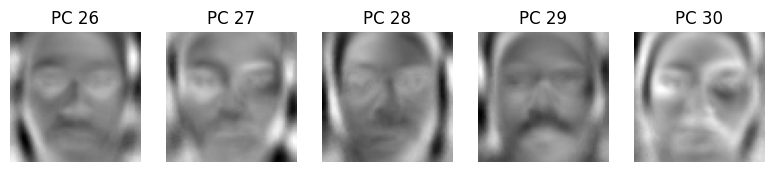

In [39]:
import pickle
import numpy as np
import matplotlib.pyplot as plt


# Check the shape of eigen_vecs
print("Shape of eigen_vecs:", eig_vecs.shape)  # Should print (4096, 30)

# Reshape and visualize the first few eigenvectors
num_components_to_plot = min(eig_vecs.shape[1],5)  # Limit to the first 5 eigenvectors for visualization
plt.figure(figsize=(50, 20))

for i in range(num_components_to_plot*5,num_components_to_plot*6):
    eigenvector = eig_vecs[:, i]  # Extract each eigenvector
    eigenvector_image = eigenvector.reshape((64, 64))  # Reshape to 64x64 image
    plt.subplot(1, num_components_to_plot*5, i - num_components_to_plot*5 + 1)
    plt.imshow(eigenvector_image, cmap='gray')
    plt.title(f'PC {i + 1}')
    plt.axis('off')

plt.show()


# USING KNN CLASSIFIER

In [71]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=12)
knn.fit(train_features, train_labels)


KNeighborsClassifier(n_neighbors=12)

In [72]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs2)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs2)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)


Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [73]:
val_pred = knn.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)
print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.4f}")

Validation Accuracy: 0.8198
Validation Precision: 0.7708


In [75]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs2)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs2)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8112 [00:00<?, ?it/s]

In [76]:
test_pred = knn.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.8292652859960552
Validation Precision: 0.7708


# USING RANDOM FOREST CLASSIFIER

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=10000, random_state=77)

rf_classifier.fit(train_features, train_labels)

In [ ]:
# Save the trained model to a file
with open('rf_classifier10000.pkl', 'wb') as f:
    pickle.dump(rf_classifier, f)

In [54]:
import pickle
with open('rf_classifier10000.pkl', 'rb') as f:
    rf_classifier = pickle.load(f)


In [55]:
rf_classifier = RandomForestClassifier(n_estimators=100000, random_state=77)

rf_classifier.fit(train_features, train_labels)

NameError: name 'RandomForestClassifier' is not defined

In [56]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [57]:
val_pred = rf_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8308
Validation Precision: 0.935681470


In [58]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8112 [00:00<?, ?it/s]

In [59]:
test_pred = rf_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.9f}")

Test Accuracy: 0.9309664694280079
Validation Precision: 0.935681470


# USING GRADIENT BOOSTING CLASSIFIER

In [272]:
!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 9.1 MB/s eta 0:00:0000:0100:01


In [62]:
import xgboost as xgb

In [63]:
xgb_classifier = xgb.XGBClassifier(
    objective='binary:logistic',  # For binary classification
    max_depth=3,                  # Maximum depth of the tree
    learning_rate=0.1,            # Learning rate
    n_estimators=8000,             # Number of trees (boosting rounds)
    subsample=0.8,                # Subsample ratio of the training instances
    colsample_bytree=0.8,         # Subsample ratio of columns when constructing each tree
    random_state=42,
    eval_metric='error',
    grow_policy='lossguide'        
    # Random state for reproducibility
)


In [64]:
xgb_classifier.fit(train_features, train_labels)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='error', feature_types=None,
              gamma=None, grow_policy='lossguide', importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=8000, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [65]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [66]:
val_pred = xgb_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8864
Validation Precision: 0.920675105


In [67]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8112 [00:00<?, ?it/s]

In [68]:
test_pred = xgb_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Test Precision: {test_precision:.9f}")

Test Accuracy: 0.9277613412228797
Test Precision: 0.906132959


# USING MLP CLASSIFIER

In [62]:
from sklearn.neural_network import MLPClassifier
mlp_classifier = MLPClassifier(hidden_layer_sizes=(256,128, 64), activation='relu', 
                               solver='adam', random_state=42, max_iter=1000, verbose=True,
                               learning_rate='adaptive',early_stopping=False,alpha=0.1,
                               learning_rate_init=0.001,n_iter_no_change=500,validation_fraction=0.1)



In [51]:
history = mlp_classifier.fit(train_features, train_labels)


Iteration 1, loss = 6.98729897
Iteration 2, loss = 3.40756879
Iteration 3, loss = 2.33712338
Iteration 4, loss = 2.16859072
Iteration 5, loss = 1.38842308
Iteration 6, loss = 1.23219484
Iteration 7, loss = 1.37962860
Iteration 8, loss = 1.08257643
Iteration 9, loss = 0.93574511
Iteration 10, loss = 0.76874902
Iteration 11, loss = 0.81941483
Iteration 12, loss = 0.57109781
Iteration 13, loss = 0.46666814
Iteration 14, loss = 0.66331803
Iteration 15, loss = 0.47517293
Iteration 16, loss = 0.42314852
Iteration 17, loss = 0.46569754
Iteration 18, loss = 0.38244370
Iteration 19, loss = 0.49971808
Iteration 20, loss = 0.35269618
Iteration 21, loss = 0.34395666
Iteration 22, loss = 0.35668506
Iteration 23, loss = 0.37016450
Iteration 24, loss = 0.31501074
Iteration 25, loss = 0.26732036
Iteration 26, loss = 0.19995900
Iteration 27, loss = 0.26045449
Iteration 28, loss = 0.25841901
Iteration 29, loss = 0.36732804
Iteration 30, loss = 0.28609968
Iteration 31, loss = 0.31852953
Iteration 32, los

Iteration 253, loss = 0.05069637
Iteration 254, loss = 0.05535559
Iteration 255, loss = 0.04902327
Iteration 256, loss = 0.04578270
Iteration 257, loss = 0.04054477
Iteration 258, loss = 0.04109798
Iteration 259, loss = 0.04679210
Iteration 260, loss = 0.06486027
Iteration 261, loss = 0.04774407
Iteration 262, loss = 0.04406970
Iteration 263, loss = 0.05471588
Iteration 264, loss = 0.05483733
Iteration 265, loss = 0.04710271
Iteration 266, loss = 0.04341411
Iteration 267, loss = 0.04444389
Iteration 268, loss = 0.04598192
Iteration 269, loss = 0.04699456
Iteration 270, loss = 0.05814830
Iteration 271, loss = 0.04133527
Iteration 272, loss = 0.03828352
Iteration 273, loss = 0.03794535
Iteration 274, loss = 0.04693933
Iteration 275, loss = 0.06380116
Iteration 276, loss = 0.04437231
Iteration 277, loss = 0.03822497
Iteration 278, loss = 0.03954008
Iteration 279, loss = 0.04686293
Iteration 280, loss = 0.04791285
Iteration 281, loss = 0.06374167
Iteration 282, loss = 0.04306073
Iteration 

Iteration 502, loss = 0.04225191
Iteration 503, loss = 0.03339211
Iteration 504, loss = 0.03083362
Iteration 505, loss = 0.03360107
Iteration 506, loss = 0.05631639
Iteration 507, loss = 0.03835942
Iteration 508, loss = 0.03235059
Iteration 509, loss = 0.03272505
Iteration 510, loss = 0.04217707
Iteration 511, loss = 0.04893995
Iteration 512, loss = 0.04856837
Iteration 513, loss = 0.03385056
Iteration 514, loss = 0.03297706
Iteration 515, loss = 0.04119903
Iteration 516, loss = 0.04273278
Iteration 517, loss = 0.03839283
Iteration 518, loss = 0.03608376
Iteration 519, loss = 0.04028319
Iteration 520, loss = 0.04053157
Iteration 521, loss = 0.03918202
Iteration 522, loss = 0.03914923
Iteration 523, loss = 0.04629733
Iteration 524, loss = 0.03609262
Iteration 525, loss = 0.03776294
Iteration 526, loss = 0.03798739
Iteration 527, loss = 0.03453674
Iteration 528, loss = 0.04000405
Iteration 529, loss = 0.03776057
Iteration 530, loss = 0.03998528
Iteration 531, loss = 0.03796055
Iteration 

Iteration 751, loss = 0.03369323
Iteration 752, loss = 0.03573456
Iteration 753, loss = 0.03863411
Iteration 754, loss = 0.03512938
Iteration 755, loss = 0.03483299
Iteration 756, loss = 0.03514363
Iteration 757, loss = 0.03345985
Iteration 758, loss = 0.03931331
Iteration 759, loss = 0.04089782
Iteration 760, loss = 0.03117574
Iteration 761, loss = 0.03114818
Iteration 762, loss = 0.02987731
Iteration 763, loss = 0.04366540
Iteration 764, loss = 0.03446229
Iteration 765, loss = 0.03261747
Iteration 766, loss = 0.03289122
Iteration 767, loss = 0.03718723
Iteration 768, loss = 0.03614708
Iteration 769, loss = 0.03218035
Iteration 770, loss = 0.04278024
Iteration 771, loss = 0.03709420
Iteration 772, loss = 0.03069543
Iteration 773, loss = 0.02743115
Iteration 774, loss = 0.03636829
Iteration 775, loss = 0.04354289
Iteration 776, loss = 0.03632502
Iteration 777, loss = 0.03036152
Iteration 778, loss = 0.03168599
Iteration 779, loss = 0.03830602
Iteration 780, loss = 0.04447569
Iteration 

Iteration 1000, loss = 0.03810520


/Users/apoorvagayatrik/miniforge3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


In [35]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [36]:
val_pred = mlp_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8758
Validation Precision: 0.911677282


In [37]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8112 [00:00<?, ?it/s]

In [38]:
test_pred = mlp_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Test Precision: {test_precision:.9f}")

Test Accuracy: 0.9340483234714004
Test Precision: 0.915310215


In [39]:
import pickle

# Save the trained model to a file
with open('mlp_classifier_64_esrgan_k30.pkl', 'wb') as f:
    pickle.dump(mlp_classifier, f)


In [24]:
import pickle
with open('mlp_classifier_64_esrgan_k30.pkl', 'rb') as f:
    mlp_classifier = pickle.load(f)


In [42]:
mlp_classifier.summary()

AttributeError: 'MLPClassifier' object has no attribute 'summary'

In [76]:
!pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.8/455.8 kB 5.0 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 21.7 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.3/11.3 MB 42.8 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.8/28.8 MB 34.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 505.5/505.5 kB 25.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.4/345.4 kB 10.5 MB/s eta 0:00:00


In [88]:
from sklearn.metrics import confusion_matrix

# Calculate confusion matrix
cm = confusion_matrix(test_labels, test_pred)


In [90]:
!pip install seaborn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 3.0 MB/s eta 0:00:00a 0:00:01


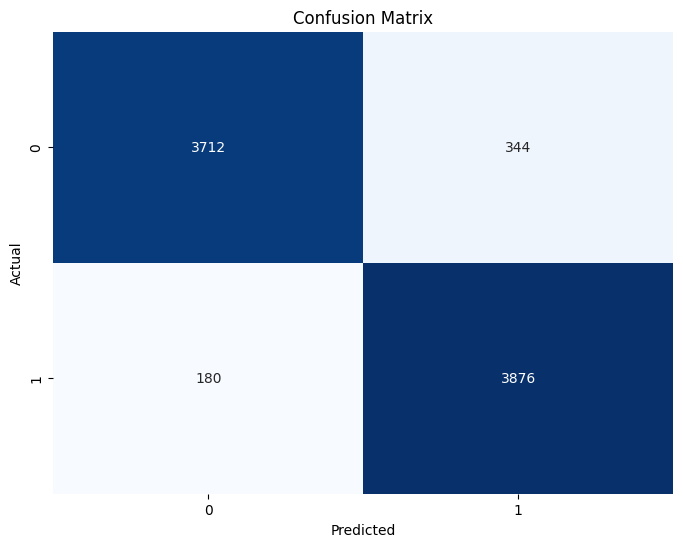

In [91]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


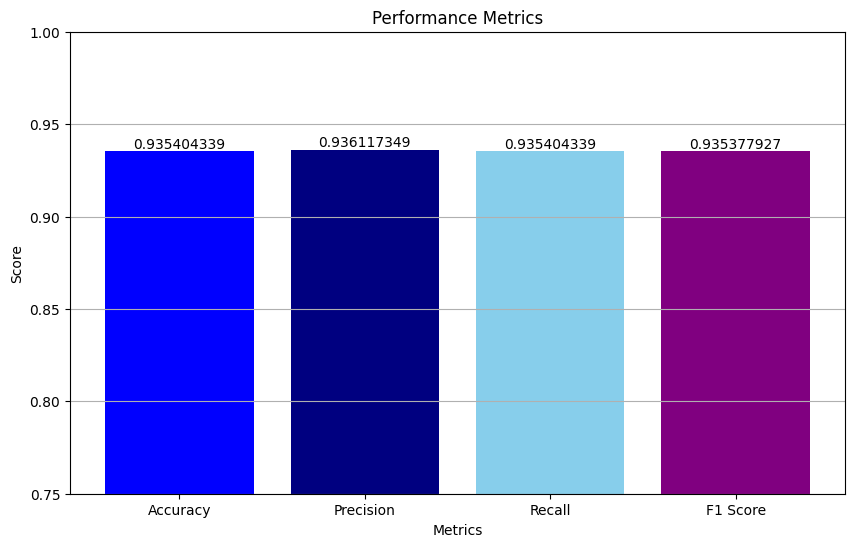

In [136]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Calculate accuracy metrics
accuracy = accuracy_score(test_labels, test_pred)
precision = precision_score(test_labels, test_pred, average='weighted')
recall = recall_score(test_labels, test_pred, average='weighted')
f1 = f1_score(test_labels, test_pred, average='weighted')

# Prepare data for plotting
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
scores = [accuracy, precision, recall, f1]

scores_formatted = [f'{score:.9f}' for score in scores]

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(metrics, scores, color=['blue', 'navy', 'skyblue', 'purple'])
plt.title('Performance Metrics')
plt.xlabel('Metrics')
plt.ylabel('Score')
plt.ylim(0.75, 1)  # Adjust the y-axis limit as needed
plt.grid(axis='y')

# Annotate bars with formatted values
for bar, score in zip(bars, scores_formatted):
    plt.text(bar.get_x() + bar.get_width() / 2., bar.get_height(), score, va='bottom', ha='center')

plt.show()

In [94]:
from sklearn.metrics import classification_report

# Print classification report for detailed metrics
print(classification_report(test_labels, test_pred))


              precision    recall  f1-score   support

           0       0.95      0.92      0.93      4056
           1       0.92      0.96      0.94      4056

    accuracy                           0.94      8112
   macro avg       0.94      0.94      0.94      8112
weighted avg       0.94      0.94      0.94      8112



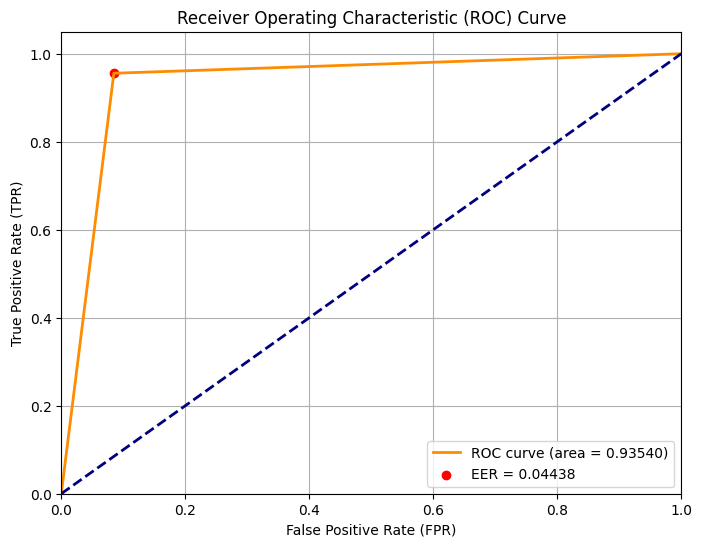

In [128]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Assuming you have calculated scores or probabilities for your test set
# test_scores = ...

# Compute ROC curve and ROC area for each class
fpr, tpr, thresholds = roc_curve(test_labels, test_pred)
roc_auc = auc(fpr, tpr)

# Find the point closest to the top-left corner (EER point)
distance = np.sqrt((1 - tpr)**2 + fpr**2)
idx_eer = np.argmin(distance)

eer = 1 - tpr[idx_eer]  # EER is at the TPR corresponding to idx_eer

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.5f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.scatter(fpr[idx_eer], tpr[idx_eer], marker='o', color='red', label=f'EER = {eer:.5f}')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


In [133]:
import time
import psutil
import tracemalloc

# Function to measure inference time
def measure_inference_time(mlp_classifier, test_features, num_runs=100):
    times = []
    for _ in range(num_runs):
        start_time = time.time()
        mlp_classifier.predict(test_features)
        times.append(time.time() - start_time)
    return times

# Function to measure memory usage
def measure_memory_usage(mlp_classifier, test_features):
    tracemalloc.start()
    mlp_classifier.predict(test_features)
    current, peak = tracemalloc.get_traced_memory()
    tracemalloc.stop()
    return current, peak

def measure_cpu_utilization(mlp_classifier, test_features):
    cpu_percentages = []
    for _ in range(10):  # Measure over a short period of time
        cpu_percent = psutil.cpu_percent(interval=0.1)
        cpu_percentages.append(cpu_percent)
    return cpu_percentages

# Assuming 'model' is your trained MLP model and 'input_data' is a sample input
times = measure_inference_time(mlp_classifier, test_features)
current_memory, peak_memory = measure_memory_usage(mlp_classifier, test_features)
cpu_utilizations = measure_cpu_utilization(mlp_classifier, test_features)

print(f'Average Inference Time: {sum(times) / len(times):.7f} seconds')
print(f'Peak Memory Usage: {peak_memory / (1024 * 1024):.2f} MB')
print(f'Average CPU Utilization: {sum(cpu_utilizations) / len(cpu_utilizations):.2f}%')


Average Inference Time: 0.0385644 seconds
Peak Memory Usage: 23.77 MB
Average CPU Utilization: 19.79%


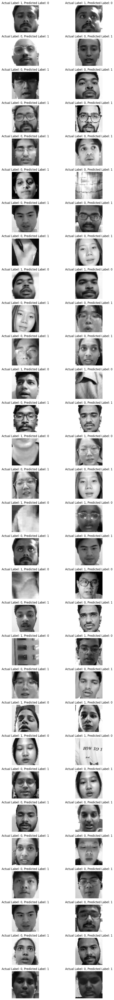

In [47]:
import matplotlib.pyplot as plt

num_samples = 30  # Number of misclassified samples to display
plt.figure(figsize=(10, 2* num_samples))
test_pred = mlp_classifier.predict(test_features)

misclassified_idx = np.where(test_labels != test_pred)[0]

for i, idx in enumerate(misclassified_idx[:num_samples]):
    img1, img2 = test_pairs[idx]
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        
    # Reshape projections into image shape (assuming 64x64)
    image1 = img1.reshape((64, 64))
    image2 = img2.reshape((64, 64))
    
    actual_label = test_labels[idx]
    predicted_label = test_pred[idx]
    
    # Display the first image pair
    plt.subplot(num_samples, 2, i * 2 + 1)
    plt.imshow(image1, cmap='gray')
    plt.title(f'Actual Label: {actual_label}, Predicted Label: {predicted_label}')
    plt.axis('off')

    # Display the second image pair
    plt.subplot(num_samples, 2, i * 2 + 2)
    plt.imshow(image2, cmap='gray')
    plt.title(f'Actual Label: {actual_label}, Predicted Label: {predicted_label}')
    plt.axis('off')
    
plt.tight_layout()
plt.show()


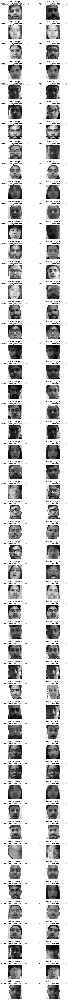

In [50]:
import matplotlib.pyplot as plt

num_samples = 50  # Number of correctly classified samples to display
plt.figure(figsize=(10, 2 * num_samples))  # Adjust figure size as needed
test_pred = mlp_classifier.predict(test_features)

correctly_classified_idx = np.where(test_labels == test_pred)[0]

for i, idx in enumerate(correctly_classified_idx[:num_samples]):
    img1, img2 = test_pairs[idx]
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        
    # Reshape projections into image shape (assuming 64x64)
    image1 = img1.reshape((64, 64))
    image2 = img2.reshape((64, 64))
    
    actual_label = test_labels[idx]
    predicted_label = test_pred[idx]
    
    # Display the first image pair
    plt.subplot(num_samples, 2, i * 2 + 1)
    plt.imshow(image1, cmap='gray')
    plt.title(f'Pair {i+1}: Image 1\nActual Label: {actual_label}, Predicted Label: {predicted_label}')
    plt.axis('off')

    # Display the second image pair
    plt.subplot(num_samples, 2, i * 2 + 2)
    plt.imshow(image2, cmap='gray')
    plt.title(f'Pair {i+1}: Image 2\nActual Label: {actual_label}, Predicted Label: {predicted_label}')
    plt.axis('off')
    
plt.tight_layout()
plt.show()


In [80]:
from collections import Counter

def analyze_class_distribution(train_labels):
    class_counts = Counter(train_labels)
    return class_counts

# Analyze class distribution
class_counts = analyze_class_distribution(train_labels)
print("Class distribution:", class_counts)


Class distribution: Counter({0: 10624, 1: 10624})


In [45]:
import matplotlib.pyplot as plt
def plot_class_distribution_pie(class_counts, title):
    classes = list(class_counts.keys())
    counts = list(class_counts.values())

    def autopct_format(values):
        def my_format(pct):
            total = sum(values)
            val = int(round(pct*total/100.0))
            return '{:.1f}% ({:d})'.format(pct, val)
        return my_format

    plt.figure(figsize=(10, 6))
    plt.pie(counts, labels=classes, autopct=autopct_format(counts), startangle=150, colors=plt.cm.Paired.colors)
    plt.title(title)
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()



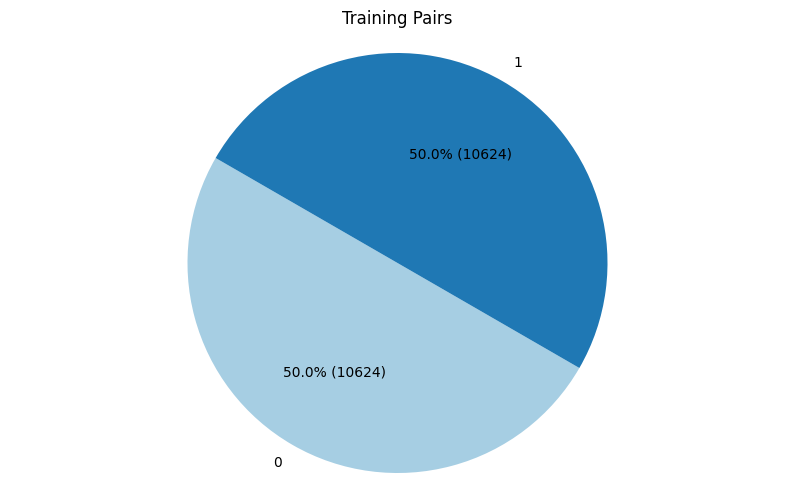

In [46]:
plot_class_distribution_pie(class_counts,'Training Pairs')


In [81]:
class_counts1 = analyze_class_distribution(val_labels)
class_counts2 = analyze_class_distribution(test_labels)

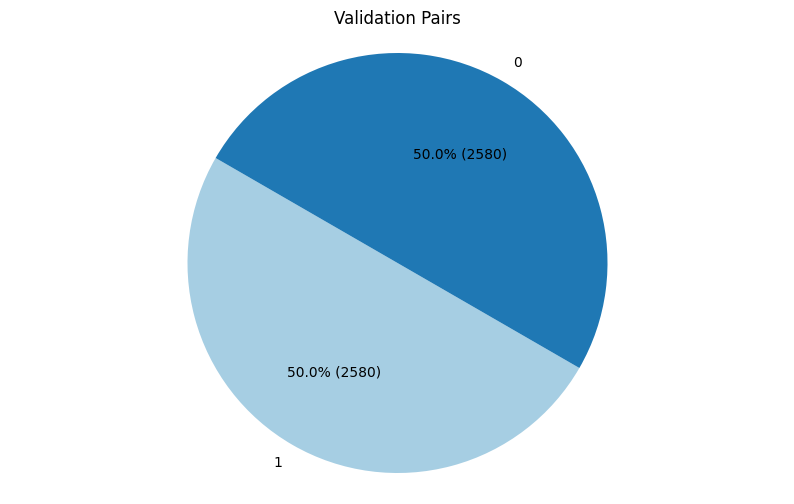

In [48]:
plot_class_distribution_pie(class_counts1,'Validation Pairs')


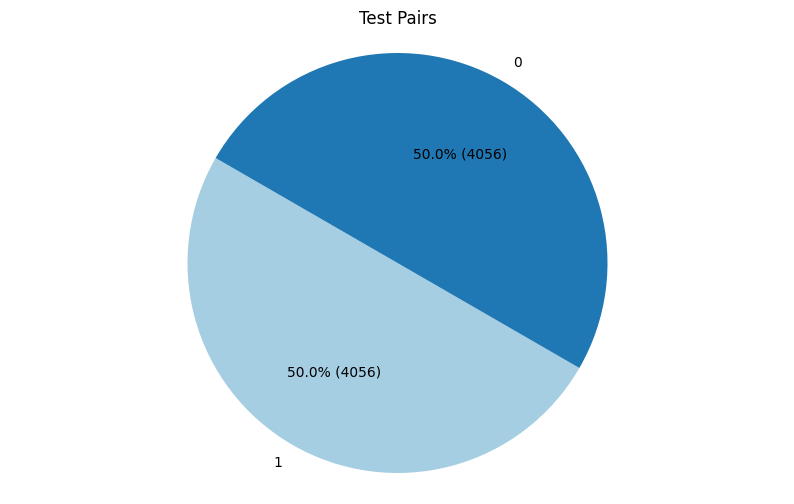

In [49]:
plot_class_distribution_pie(class_counts2,'Test Pairs')


In [82]:
def plot_class_distribution_bar(class_counts, title):
    classes = list(class_counts.keys())
    counts = list(class_counts.values())

    plt.figure(figsize=(10, 6))
    plt.bar(classes, counts, color='skyblue')
    plt.xlabel('Classes')
    plt.ylabel('Number of Samples')
    plt.title(title)
    plt.xticks(rotation=45)
    plt.show()

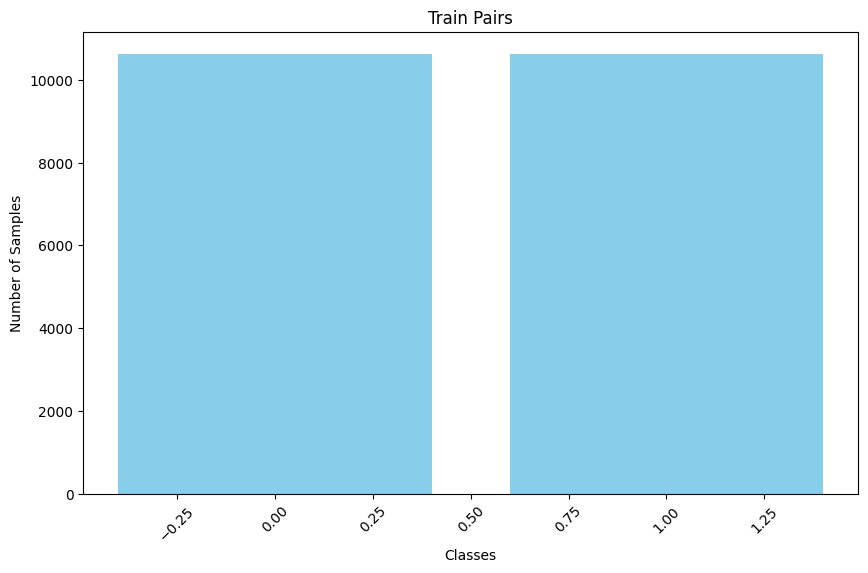

In [83]:
plot_class_distribution_bar(class_counts,'Train Pairs')


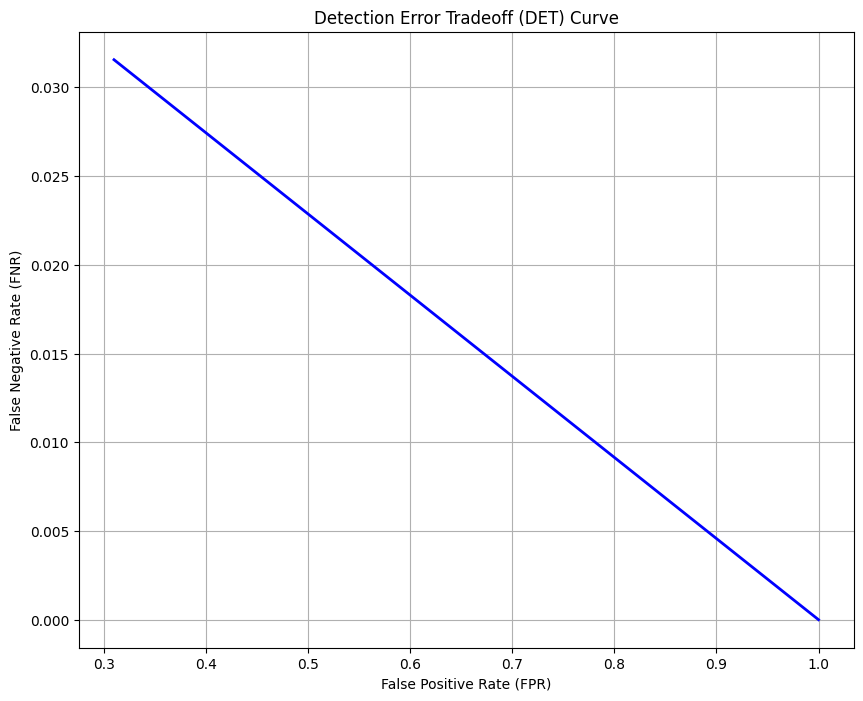

In [84]:
from sklearn.metrics import det_curve

# Assuming you have test_labels and test_scores (the predicted scores from your classifier)
# test_labels: array of true labels
# test_scores: array of predicted scores (probabilities or decision function values)

# Calculate false positive rate (FPR), false negative rate (FNR), and thresholds
fpr, fnr, thresholds = det_curve(test_labels, test_pred)

# Plot the DET curve
plt.figure(figsize=(10, 8))
plt.plot(fpr, fnr, color='blue', lw=2)
plt.title('Detection Error Tradeoff (DET) Curve')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('False Negative Rate (FNR)')
plt.grid(True)
plt.show()


In [52]:
loss_values = history.history['loss']
epochs = range(1, len(loss_values) + 1)

# Plotting loss versus iteration
plt.figure(figsize=(10, 6))
plt.plot(epochs, loss_values, label='Training Loss')
plt.title('Training Loss vs. Iteration')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

AttributeError: 'MLPClassifier' object has no attribute 'history'

In [7]:
train_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images96/train_ds'
test_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images96/test_ds'
val_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images96/val_ds'

In [8]:
train_pairs, train_labels = generate_pairs(train_dir)
val_pairs, val_labels = generate_pairs(val_dir)
test_pairs, test_labels = generate_pairs(test_dir)
print(f"Generated {len(train_pairs)} pairs with {np.sum(train_labels)} positives and {len(train_labels) - np.sum(train_labels)} negatives")
print(f"Generated {len(val_pairs)} pairs with {np.sum(val_labels)} positives and {len(val_labels) - np.sum(val_labels)} negatives")
print(f"Generated {len(test_pairs)} pairs with {np.sum(test_labels)} positives and {len(test_labels) - np.sum(test_labels)} negatives")


Generated 21210 pairs with 10605 positives and 10605 negatives
Generated 5160 pairs with 2580 positives and 2580 negatives
Generated 8156 pairs with 4078 positives and 4078 negatives


In [9]:
import pickle
with open('eig_vecs96k30.pkl', 'rb') as f:
    eig_vecs = pickle.load(f)
print(eig_vecs.shape)

(9216, 30)


In [10]:
train_features = []
for img1, img2 in tqdm(train_pairs, desc='Training pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    train_features.append(np.concatenate([proj_img1, proj_img2]))
train_features = np.array(train_features)

Training pairs:   0%|          | 0/21210 [00:00<?, ?it/s]

In [11]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=10000, random_state=77)

rf_classifier.fit(train_features, train_labels)

RandomForestClassifier(n_estimators=10000, random_state=77)

In [12]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [13]:
val_pred = rf_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8440
Validation Precision: 0.951653944


In [14]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8156 [00:00<?, ?it/s]

In [18]:
test_pred = rf_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9310936733692987
Validation Precision: 0.9517


In [19]:
from sklearn.neural_network import MLPClassifier
mlp_classifier = MLPClassifier(hidden_layer_sizes=(256,128, 64), activation='relu', 
                               solver='adam', random_state=42, max_iter=1000, verbose=True,
                               learning_rate='adaptive',early_stopping=False,alpha=0.1,
                               learning_rate_init=0.001,n_iter_no_change=500,validation_fraction=0.1)


In [21]:
history = mlp_classifier.fit(train_features, train_labels)


Iteration 1, loss = 7.97181073
Iteration 2, loss = 3.73413713
Iteration 3, loss = 3.60963825
Iteration 4, loss = 2.24375318
Iteration 5, loss = 1.81675298
Iteration 6, loss = 2.26146034
Iteration 7, loss = 1.45001456
Iteration 8, loss = 1.81763665
Iteration 9, loss = 1.25689226
Iteration 10, loss = 0.98584021
Iteration 11, loss = 0.90176377
Iteration 12, loss = 1.27212897
Iteration 13, loss = 0.87916881
Iteration 14, loss = 0.78173867
Iteration 15, loss = 0.64096672
Iteration 16, loss = 0.53918031
Iteration 17, loss = 0.54034098
Iteration 18, loss = 0.68544684
Iteration 19, loss = 0.85121463
Iteration 20, loss = 0.46644598
Iteration 21, loss = 0.82855495
Iteration 22, loss = 0.39281666
Iteration 23, loss = 0.44717903
Iteration 24, loss = 0.34555449
Iteration 25, loss = 0.48269533
Iteration 26, loss = 0.53030270
Iteration 27, loss = 0.35173936
Iteration 28, loss = 0.31873687
Iteration 29, loss = 0.29936649
Iteration 30, loss = 0.30032359
Iteration 31, loss = 0.33092554
Iteration 32, los

Iteration 253, loss = 0.05203341
Iteration 254, loss = 0.05404523
Iteration 255, loss = 0.04690393
Iteration 256, loss = 0.04138635
Iteration 257, loss = 0.04371514
Iteration 258, loss = 0.05930467
Iteration 259, loss = 0.05044406
Iteration 260, loss = 0.04379591
Iteration 261, loss = 0.04606045
Iteration 262, loss = 0.05408948
Iteration 263, loss = 0.05401475
Iteration 264, loss = 0.05325086
Iteration 265, loss = 0.06307396
Iteration 266, loss = 0.04567610
Iteration 267, loss = 0.04949131
Iteration 268, loss = 0.04427577
Iteration 269, loss = 0.05124105
Iteration 270, loss = 0.05050141
Iteration 271, loss = 0.04357836
Iteration 272, loss = 0.05906188
Iteration 273, loss = 0.10127038
Iteration 274, loss = 0.04737426
Iteration 275, loss = 0.04187343
Iteration 276, loss = 0.03776047
Iteration 277, loss = 0.03994945
Iteration 278, loss = 0.05342808
Iteration 279, loss = 0.04887516
Iteration 280, loss = 0.04735679
Iteration 281, loss = 0.04783487
Iteration 282, loss = 0.04394553
Iteration 

Iteration 502, loss = 0.03939039
Iteration 503, loss = 0.03611136
Iteration 504, loss = 0.03348780
Iteration 505, loss = 0.04004368
Iteration 506, loss = 0.04331420
Iteration 507, loss = 0.04884551
Iteration 508, loss = 0.03713869
Iteration 509, loss = 0.03941548
Iteration 510, loss = 0.04142016
Iteration 511, loss = 0.03498540
Iteration 512, loss = 0.03112297
Iteration 513, loss = 0.03450631
Iteration 514, loss = 0.05248329
Iteration 515, loss = 0.04266543
Iteration 516, loss = 0.03852865
Iteration 517, loss = 0.04519833
Iteration 518, loss = 0.04798093
Iteration 519, loss = 0.03886001
Iteration 520, loss = 0.03588128
Iteration 521, loss = 0.03865752
Iteration 522, loss = 0.04579885
Iteration 523, loss = 0.03663875
Iteration 524, loss = 0.04046344
Iteration 525, loss = 0.05679485
Iteration 526, loss = 0.04017809
Iteration 527, loss = 0.03596792
Iteration 528, loss = 0.03611271
Iteration 529, loss = 0.03977755
Iteration 530, loss = 0.04272138
Iteration 531, loss = 0.03857561
Iteration 

Iteration 751, loss = 0.03721035
Iteration 752, loss = 0.03687848
Iteration 753, loss = 0.03325678
Iteration 754, loss = 0.05726002
Iteration 755, loss = 0.03471589
Iteration 756, loss = 0.03588269
Iteration 757, loss = 0.03571652
Iteration 758, loss = 0.04321498
Iteration 759, loss = 0.03401013
Iteration 760, loss = 0.03311391
Iteration 761, loss = 0.03435013
Iteration 762, loss = 0.04665849
Iteration 763, loss = 0.03596964
Iteration 764, loss = 0.03081992
Iteration 765, loss = 0.03224834
Iteration 766, loss = 0.03322556
Iteration 767, loss = 0.03845464
Iteration 768, loss = 0.03408510
Iteration 769, loss = 0.03539525
Iteration 770, loss = 0.04061426
Iteration 771, loss = 0.03343304
Iteration 772, loss = 0.03549192
Iteration 773, loss = 0.03310989
Iteration 774, loss = 0.03983948
Iteration 775, loss = 0.03692047
Iteration 776, loss = 0.03614698
Iteration 777, loss = 0.04140322
Iteration 778, loss = 0.04036031
Iteration 779, loss = 0.03457666
Iteration 780, loss = 0.04142657
Iteration 

Iteration 1000, loss = 0.03915863


/Users/apoorvagayatrik/miniforge3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


In [22]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [23]:
val_pred = mlp_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8692
Validation Precision: 0.902748414


In [24]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8156 [00:00<?, ?it/s]

In [25]:
test_pred = mlp_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9232466895537028
Validation Precision: 0.9027


In [67]:
train_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images128/train_ds'
test_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images128/test_ds'
val_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images128/val_ds'

In [68]:
train_pairs, train_labels = generate_pairs(train_dir)
val_pairs, val_labels = generate_pairs(val_dir)
test_pairs, test_labels = generate_pairs(test_dir)
print(f"Generated {len(train_pairs)} pairs with {np.sum(train_labels)} positives and {len(train_labels) - np.sum(train_labels)} negatives")
print(f"Generated {len(val_pairs)} pairs with {np.sum(val_labels)} positives and {len(val_labels) - np.sum(val_labels)} negatives")
print(f"Generated {len(test_pairs)} pairs with {np.sum(test_labels)} positives and {len(test_labels) - np.sum(test_labels)} negatives")


Generated 21210 pairs with 10605 positives and 10605 negatives
Generated 5160 pairs with 2580 positives and 2580 negatives
Generated 8156 pairs with 4078 positives and 4078 negatives


In [69]:
import pickle
with open('eig_vecs128k30.pkl', 'rb') as f:
    eig_vecs = pickle.load(f)
print(eig_vecs.shape)

(16384, 30)


In [70]:
train_features = []
for img1, img2 in tqdm(train_pairs, desc='Training pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    train_features.append(np.concatenate([proj_img1, proj_img2]))
train_features = np.array(train_features)

Training pairs:   0%|          | 0/21210 [00:00<?, ?it/s]

In [30]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=10000, random_state=77)

rf_classifier.fit(train_features, train_labels)

RandomForestClassifier(n_estimators=10000, random_state=77)

In [31]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [32]:
val_pred = rf_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8322
Validation Precision: 0.943581781


In [33]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8156 [00:00<?, ?it/s]

In [34]:
test_pred = mlp_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.8868317802844532
Validation Precision: 0.9436


In [71]:
from sklearn.neural_network import MLPClassifier
mlp_classifier = MLPClassifier(hidden_layer_sizes=(256,128, 64), activation='relu', 
                               solver='adam', random_state=42, max_iter=1000, verbose=True,
                               learning_rate='adaptive',early_stopping=False,alpha=0.1,
                               learning_rate_init=0.001,n_iter_no_change=500,validation_fraction=0.1)


In [72]:
history = mlp_classifier.fit(train_features, train_labels)


Iteration 1, loss = 7.19910989
Iteration 2, loss = 4.79685733
Iteration 3, loss = 3.55024878
Iteration 4, loss = 3.67331231
Iteration 5, loss = 2.38040313
Iteration 6, loss = 2.47361067
Iteration 7, loss = 1.72495440
Iteration 8, loss = 1.83889892
Iteration 9, loss = 1.87986128
Iteration 10, loss = 1.56145871
Iteration 11, loss = 1.13118082
Iteration 12, loss = 1.10154055
Iteration 13, loss = 1.17420241
Iteration 14, loss = 0.84498924
Iteration 15, loss = 1.08106967
Iteration 16, loss = 1.21877021
Iteration 17, loss = 1.29678028
Iteration 18, loss = 0.84106888
Iteration 19, loss = 0.69159019
Iteration 20, loss = 0.76341124
Iteration 21, loss = 0.45623474
Iteration 22, loss = 0.53454888
Iteration 23, loss = 0.65678438
Iteration 24, loss = 0.69719600
Iteration 25, loss = 0.43298890
Iteration 26, loss = 0.52863894
Iteration 27, loss = 0.93927280
Iteration 28, loss = 0.52538864
Iteration 29, loss = 0.34126573
Iteration 30, loss = 0.47948390
Iteration 31, loss = 0.26148355
Iteration 32, los

Iteration 253, loss = 0.05303262
Iteration 254, loss = 0.05578081
Iteration 255, loss = 0.05907328
Iteration 256, loss = 0.06762880
Iteration 257, loss = 0.04919847
Iteration 258, loss = 0.04679612
Iteration 259, loss = 0.04384096
Iteration 260, loss = 0.05271493
Iteration 261, loss = 0.05452567
Iteration 262, loss = 0.04572987
Iteration 263, loss = 0.05052806
Iteration 264, loss = 0.05195693
Iteration 265, loss = 0.05099717
Iteration 266, loss = 0.04601365
Iteration 267, loss = 0.05884379
Iteration 268, loss = 0.05248113
Iteration 269, loss = 0.04609127
Iteration 270, loss = 0.05225808
Iteration 271, loss = 0.04717636
Iteration 272, loss = 0.05999121
Iteration 273, loss = 0.04957692
Iteration 274, loss = 0.04896957
Iteration 275, loss = 0.04460862
Iteration 276, loss = 0.05120911
Iteration 277, loss = 0.05158634
Iteration 278, loss = 0.04404313
Iteration 279, loss = 0.04893838
Iteration 280, loss = 0.04777898
Iteration 281, loss = 0.04370312
Iteration 282, loss = 0.05046179
Iteration 

Iteration 502, loss = 0.03842852
Iteration 503, loss = 0.03735119
Iteration 504, loss = 0.05023720
Iteration 505, loss = 0.03600458
Iteration 506, loss = 0.03693897
Iteration 507, loss = 0.04801962
Iteration 508, loss = 0.03924322
Iteration 509, loss = 0.03930727
Iteration 510, loss = 0.03694125
Iteration 511, loss = 0.03335784
Iteration 512, loss = 0.04130631
Iteration 513, loss = 0.04457287
Iteration 514, loss = 0.03599432
Iteration 515, loss = 0.03866252
Iteration 516, loss = 0.03945731
Iteration 517, loss = 0.03966207
Iteration 518, loss = 0.04275060
Iteration 519, loss = 0.03376604
Iteration 520, loss = 0.03899857
Iteration 521, loss = 0.03672284
Iteration 522, loss = 0.04688290
Iteration 523, loss = 0.03682168
Iteration 524, loss = 0.03790762
Iteration 525, loss = 0.03583742
Iteration 526, loss = 0.04036072
Iteration 527, loss = 0.03976226
Iteration 528, loss = 0.03196080
Iteration 529, loss = 0.03528839
Iteration 530, loss = 0.04600150
Iteration 531, loss = 0.03702773
Iteration 

Iteration 751, loss = 0.04999870
Iteration 752, loss = 0.03303230
Iteration 753, loss = 0.03401498
Iteration 754, loss = 0.03580679
Iteration 755, loss = 0.03277847
Iteration 756, loss = 0.03070342
Iteration 757, loss = 0.03848319
Iteration 758, loss = 0.03765694
Iteration 759, loss = 0.03393652
Iteration 760, loss = 0.04117820
Iteration 761, loss = 0.03751985
Iteration 762, loss = 0.03484776
Iteration 763, loss = 0.03523208
Iteration 764, loss = 0.03843885
Iteration 765, loss = 0.03888901
Iteration 766, loss = 0.03512400
Iteration 767, loss = 0.03972675
Iteration 768, loss = 0.03350293
Iteration 769, loss = 0.03472192
Iteration 770, loss = 0.03278636
Iteration 771, loss = 0.03846702
Iteration 772, loss = 0.03961451
Iteration 773, loss = 0.03816204
Iteration 774, loss = 0.03680148
Iteration 775, loss = 0.03299380
Iteration 776, loss = 0.02840596
Iteration 777, loss = 0.03659774
Iteration 778, loss = 0.03324275
Iteration 779, loss = 0.04383676
Iteration 780, loss = 0.04182835
Iteration 

Iteration 1000, loss = 0.03673446


/Users/apoorvagayatrik/miniforge3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


In [73]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [74]:
val_pred = mlp_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8798
Validation Precision: 0.921686747


In [75]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8156 [00:00<?, ?it/s]

In [76]:
test_pred = mlp_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9241049534085336
Validation Precision: 0.9217


In [35]:
train_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images_noesrgan/train_ds'
test_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images_noesrgan/test_ds'
val_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images_noesrgan/val_ds'

In [36]:
train_pairs, train_labels = generate_pairs(train_dir)
val_pairs, val_labels = generate_pairs(val_dir)
test_pairs, test_labels = generate_pairs(test_dir)
print(f"Generated {len(train_pairs)} pairs with {np.sum(train_labels)} positives and {len(train_labels) - np.sum(train_labels)} negatives")
print(f"Generated {len(val_pairs)} pairs with {np.sum(val_labels)} positives and {len(val_labels) - np.sum(val_labels)} negatives")
print(f"Generated {len(test_pairs)} pairs with {np.sum(test_labels)} positives and {len(test_labels) - np.sum(test_labels)} negatives")


Generated 21210 pairs with 10605 positives and 10605 negatives
Generated 5160 pairs with 2580 positives and 2580 negatives
Generated 8156 pairs with 4078 positives and 4078 negatives


In [39]:
with open('eig_vecsnoesrgank30.pkl', 'rb') as f:
    eig_vecs = pickle.load(f)
print(eig_vecs.shape)

(4096, 30)


In [40]:
train_features = []
for img1, img2 in tqdm(train_pairs, desc='Training pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    train_features.append(np.concatenate([proj_img1, proj_img2]))
train_features = np.array(train_features)

Training pairs:   0%|          | 0/21210 [00:00<?, ?it/s]

In [41]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=10000, random_state=77)

rf_classifier.fit(train_features, train_labels)

RandomForestClassifier(n_estimators=10000, random_state=77)

In [42]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [43]:
val_pred = rf_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8343
Validation Precision: 0.952281070


In [44]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8156 [00:00<?, ?it/s]

In [45]:
test_pred = rf_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9364884747425208
Validation Precision: 0.9523


In [46]:
from sklearn.neural_network import MLPClassifier
mlp_classifier = MLPClassifier(hidden_layer_sizes=(256,128, 64), activation='relu', 
                               solver='adam', random_state=42, max_iter=1000, verbose=True,
                               learning_rate='adaptive',early_stopping=False,alpha=0.1,
                               learning_rate_init=0.001,n_iter_no_change=500,validation_fraction=0.1)


In [47]:
history = mlp_classifier.fit(train_features, train_labels)


Iteration 1, loss = 6.73890940
Iteration 2, loss = 3.28988590
Iteration 3, loss = 2.58406506
Iteration 4, loss = 2.15493741
Iteration 5, loss = 1.73145258
Iteration 6, loss = 1.59125567
Iteration 7, loss = 1.09767331
Iteration 8, loss = 1.44890783
Iteration 9, loss = 0.96000203
Iteration 10, loss = 0.86993501
Iteration 11, loss = 0.71188994
Iteration 12, loss = 0.66134457
Iteration 13, loss = 0.52310695
Iteration 14, loss = 0.38226611
Iteration 15, loss = 0.37011913
Iteration 16, loss = 0.40880595
Iteration 17, loss = 0.38316661
Iteration 18, loss = 0.40918127
Iteration 19, loss = 0.51185286
Iteration 20, loss = 0.48749890
Iteration 21, loss = 0.33573125
Iteration 22, loss = 0.31890597
Iteration 23, loss = 0.30805149
Iteration 24, loss = 0.29437849
Iteration 25, loss = 0.26126844
Iteration 26, loss = 0.20902310
Iteration 27, loss = 0.29377685
Iteration 28, loss = 0.43119517
Iteration 29, loss = 0.29952001
Iteration 30, loss = 0.20579908
Iteration 31, loss = 0.21873042
Iteration 32, los

Iteration 253, loss = 0.04872597
Iteration 254, loss = 0.04149329
Iteration 255, loss = 0.04673999
Iteration 256, loss = 0.05727560
Iteration 257, loss = 0.05661729
Iteration 258, loss = 0.04638109
Iteration 259, loss = 0.04238838
Iteration 260, loss = 0.04613344
Iteration 261, loss = 0.04809360
Iteration 262, loss = 0.05563355
Iteration 263, loss = 0.04747523
Iteration 264, loss = 0.04993826
Iteration 265, loss = 0.04284951
Iteration 266, loss = 0.05025751
Iteration 267, loss = 0.04831583
Iteration 268, loss = 0.04819615
Iteration 269, loss = 0.05124177
Iteration 270, loss = 0.05327694
Iteration 271, loss = 0.04604695
Iteration 272, loss = 0.04049901
Iteration 273, loss = 0.03685456
Iteration 274, loss = 0.04062298
Iteration 275, loss = 0.04936909
Iteration 276, loss = 0.05824887
Iteration 277, loss = 0.05319212
Iteration 278, loss = 0.04547741
Iteration 279, loss = 0.04776693
Iteration 280, loss = 0.04782463
Iteration 281, loss = 0.08389699
Iteration 282, loss = 0.04572090
Iteration 

Iteration 502, loss = 0.03991247
Iteration 503, loss = 0.03540134
Iteration 504, loss = 0.04573675
Iteration 505, loss = 0.04206986
Iteration 506, loss = 0.03322678
Iteration 507, loss = 0.03778394
Iteration 508, loss = 0.04351107
Iteration 509, loss = 0.05025338
Iteration 510, loss = 0.04032580
Iteration 511, loss = 0.03534909
Iteration 512, loss = 0.03363475
Iteration 513, loss = 0.03134025
Iteration 514, loss = 0.03784196
Iteration 515, loss = 0.04904099
Iteration 516, loss = 0.03460935
Iteration 517, loss = 0.04484093
Iteration 518, loss = 0.04210791
Iteration 519, loss = 0.04376918
Iteration 520, loss = 0.03685204
Iteration 521, loss = 0.03340603
Iteration 522, loss = 0.03398162
Iteration 523, loss = 0.04323693
Iteration 524, loss = 0.04141218
Iteration 525, loss = 0.04765067
Iteration 526, loss = 0.05456048
Iteration 527, loss = 0.03786834
Iteration 528, loss = 0.03690344
Iteration 529, loss = 0.07473124
Iteration 530, loss = 0.04813592
Iteration 531, loss = 0.04288961
Iteration 

Iteration 751, loss = 0.03418109
Iteration 752, loss = 0.03590215
Iteration 753, loss = 0.03661502
Iteration 754, loss = 0.03690266
Iteration 755, loss = 0.03695152
Iteration 756, loss = 0.04261863
Iteration 757, loss = 0.03682355
Iteration 758, loss = 0.06722521
Iteration 759, loss = 0.07063761
Iteration 760, loss = 0.03779344
Iteration 761, loss = 0.03298144
Iteration 762, loss = 0.03135312
Iteration 763, loss = 0.03328185
Iteration 764, loss = 0.02977306
Iteration 765, loss = 0.02963517
Iteration 766, loss = 0.04155701
Iteration 767, loss = 0.03534213
Iteration 768, loss = 0.03267839
Iteration 769, loss = 0.03464602
Iteration 770, loss = 0.03223416
Iteration 771, loss = 0.03827716
Iteration 772, loss = 0.03756862
Iteration 773, loss = 0.03599511
Iteration 774, loss = 0.02999034
Iteration 775, loss = 0.03584936
Iteration 776, loss = 0.03960021
Iteration 777, loss = 0.03499442
Iteration 778, loss = 0.04168455
Iteration 779, loss = 0.03599254
Iteration 780, loss = 0.03323795
Iteration 

Iteration 1000, loss = 0.03062510


/Users/apoorvagayatrik/miniforge3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


In [48]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [49]:
val_pred = mlp_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8636
Validation Precision: 0.936279070


In [50]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8156 [00:00<?, ?it/s]

In [51]:
test_pred = mlp_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9320745463462482
Validation Precision: 0.9363


In [52]:
train_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images/train_ds'
test_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images/test_ds'
val_dir='/Users/apoorvagayatrik/PerspectAIProj/processed_images/val_ds'

In [53]:
train_pairs, train_labels = generate_pairs(train_dir)
val_pairs, val_labels = generate_pairs(val_dir)
test_pairs, test_labels = generate_pairs(test_dir)
print(f"Generated {len(train_pairs)} pairs with {np.sum(train_labels)} positives and {len(train_labels) - np.sum(train_labels)} negatives")
print(f"Generated {len(val_pairs)} pairs with {np.sum(val_labels)} positives and {len(val_labels) - np.sum(val_labels)} negatives")
print(f"Generated {len(test_pairs)} pairs with {np.sum(test_labels)} positives and {len(test_labels) - np.sum(test_labels)} negatives")


Generated 21248 pairs with 10624 positives and 10624 negatives
Generated 5160 pairs with 2580 positives and 2580 negatives
Generated 8112 pairs with 4056 positives and 4056 negatives


In [54]:
with open('eig_vecsk30.pkl', 'rb') as f:
    eig_vecs = pickle.load(f)
print(eig_vecs.shape)

(4096, 30)


In [55]:
train_features = []
for img1, img2 in tqdm(train_pairs, desc='Training pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    train_features.append(np.concatenate([proj_img1, proj_img2]))
train_features = np.array(train_features)

Training pairs:   0%|          | 0/21248 [00:00<?, ?it/s]

In [56]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=10000, random_state=77)

rf_classifier.fit(train_features, train_labels)

RandomForestClassifier(n_estimators=10000, random_state=77)

In [57]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [58]:
val_pred = rf_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8382
Validation Precision: 0.948125321


In [59]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8112 [00:00<?, ?it/s]

In [60]:
test_pred = rf_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9223372781065089
Validation Precision: 0.9481


In [61]:
from sklearn.neural_network import MLPClassifier
mlp_classifier = MLPClassifier(hidden_layer_sizes=(256,128, 64), activation='relu', 
                               solver='adam', random_state=42, max_iter=1000, verbose=True,
                               learning_rate='adaptive',early_stopping=False,alpha=0.1,
                               learning_rate_init=0.001,n_iter_no_change=500,validation_fraction=0.1)


In [62]:
history = mlp_classifier.fit(train_features, train_labels)


Iteration 1, loss = 7.01441929
Iteration 2, loss = 3.24434360
Iteration 3, loss = 2.23118238
Iteration 4, loss = 2.01144025
Iteration 5, loss = 1.37736078
Iteration 6, loss = 1.39228872
Iteration 7, loss = 1.38991077
Iteration 8, loss = 0.98672566
Iteration 9, loss = 1.00388475
Iteration 10, loss = 0.70693161
Iteration 11, loss = 0.70631598
Iteration 12, loss = 0.73372504
Iteration 13, loss = 0.67095220
Iteration 14, loss = 0.42405987
Iteration 15, loss = 0.40733865
Iteration 16, loss = 0.63570197
Iteration 17, loss = 0.44329960
Iteration 18, loss = 0.37797183
Iteration 19, loss = 0.37209467
Iteration 20, loss = 0.37693254
Iteration 21, loss = 0.26366464
Iteration 22, loss = 0.31183165
Iteration 23, loss = 0.29561905
Iteration 24, loss = 0.27738477
Iteration 25, loss = 0.34650922
Iteration 26, loss = 0.25479465
Iteration 27, loss = 0.24801157
Iteration 28, loss = 0.30816932
Iteration 29, loss = 0.33367759
Iteration 30, loss = 0.22239966
Iteration 31, loss = 0.29897810
Iteration 32, los

Iteration 253, loss = 0.05663720
Iteration 254, loss = 0.05715907
Iteration 255, loss = 0.05637016
Iteration 256, loss = 0.04910492
Iteration 257, loss = 0.04786377
Iteration 258, loss = 0.05101281
Iteration 259, loss = 0.05204925
Iteration 260, loss = 0.04792320
Iteration 261, loss = 0.05021446
Iteration 262, loss = 0.06168930
Iteration 263, loss = 0.05565615
Iteration 264, loss = 0.04891478
Iteration 265, loss = 0.04224029
Iteration 266, loss = 0.03935883
Iteration 267, loss = 0.04508922
Iteration 268, loss = 0.06356722
Iteration 269, loss = 0.05806734
Iteration 270, loss = 0.06025932
Iteration 271, loss = 0.05617491
Iteration 272, loss = 0.04814185
Iteration 273, loss = 0.04482624
Iteration 274, loss = 0.05312562
Iteration 275, loss = 0.04842357
Iteration 276, loss = 0.06132681
Iteration 277, loss = 0.05739263
Iteration 278, loss = 0.04822749
Iteration 279, loss = 0.04819909
Iteration 280, loss = 0.04728365
Iteration 281, loss = 0.05230250
Iteration 282, loss = 0.04864334
Iteration 

Iteration 502, loss = 0.04201018
Iteration 503, loss = 0.03752547
Iteration 504, loss = 0.04105190
Iteration 505, loss = 0.03753927
Iteration 506, loss = 0.04413224
Iteration 507, loss = 0.03767959
Iteration 508, loss = 0.03727496
Iteration 509, loss = 0.03860045
Iteration 510, loss = 0.03911735
Iteration 511, loss = 0.03695021
Iteration 512, loss = 0.05126038
Iteration 513, loss = 0.03912934
Iteration 514, loss = 0.04123493
Iteration 515, loss = 0.03512771
Iteration 516, loss = 0.04521387
Iteration 517, loss = 0.04292741
Iteration 518, loss = 0.03658704
Iteration 519, loss = 0.03805277
Iteration 520, loss = 0.03939873
Iteration 521, loss = 0.03963628
Iteration 522, loss = 0.03957661
Iteration 523, loss = 0.03940364
Iteration 524, loss = 0.05185020
Iteration 525, loss = 0.03872051
Iteration 526, loss = 0.04029499
Iteration 527, loss = 0.03818826
Iteration 528, loss = 0.03400281
Iteration 529, loss = 0.04864912
Iteration 530, loss = 0.04205807
Iteration 531, loss = 0.04419196
Iteration 

Iteration 751, loss = 0.03065939
Iteration 752, loss = 0.03588284
Iteration 753, loss = 0.03368674
Iteration 754, loss = 0.03849289
Iteration 755, loss = 0.03177992
Iteration 756, loss = 0.04055962
Iteration 757, loss = 0.04009104
Iteration 758, loss = 0.03221378
Iteration 759, loss = 0.03072931
Iteration 760, loss = 0.03256197
Iteration 761, loss = 0.04078288
Iteration 762, loss = 0.04008190
Iteration 763, loss = 0.03523026
Iteration 764, loss = 0.04001328
Iteration 765, loss = 0.03822810
Iteration 766, loss = 0.03703204
Iteration 767, loss = 0.03198810
Iteration 768, loss = 0.02956684
Iteration 769, loss = 0.03231752
Iteration 770, loss = 0.03591503
Iteration 771, loss = 0.04273867
Iteration 772, loss = 0.03911880
Iteration 773, loss = 0.03200583
Iteration 774, loss = 0.03340763
Iteration 775, loss = 0.04243870
Iteration 776, loss = 0.04026124
Iteration 777, loss = 0.03564608
Iteration 778, loss = 0.03483330
Iteration 779, loss = 0.04295719
Iteration 780, loss = 0.03503734
Iteration 

Iteration 1000, loss = 0.04532098


/Users/apoorvagayatrik/miniforge3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


In [63]:
val_features = []
for img1, img2 in tqdm(val_pairs, desc='Validation pairs'):
    proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
    proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
    val_features.append(np.concatenate([proj_img1, proj_img2]))
val_features = np.array(val_features)

Validation pairs:   0%|          | 0/5160 [00:00<?, ?it/s]

In [64]:
val_pred = mlp_classifier.predict(val_features)
val_accuracy = accuracy_score(val_labels, val_pred)
val_precision=precision_score(val_labels, val_pred)

print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.9f}")

Validation Accuracy: 0.8771
Validation Precision: 0.945105215


In [65]:
test_features = []
for img1, img2 in tqdm(test_pairs, desc='Test pairs'):
        proj_img1 = project_2dpca(img1.flatten(), eig_vecs)
        proj_img2 = project_2dpca(img2.flatten(), eig_vecs)
        test_features.append(np.concatenate([proj_img1, proj_img2]))
test_features = np.array(test_features)

Test pairs:   0%|          | 0/8112 [00:00<?, ?it/s]

In [66]:
test_pred = mlp_classifier.predict(test_features)
test_accuracy = accuracy_score(test_labels, test_pred)
test_precision=precision_score(test_labels, test_pred)

print(f"Test Accuracy: {test_accuracy}")
print(f"Validation Precision: {val_precision:.4f}")

Test Accuracy: 0.9299802761341223
Validation Precision: 0.9451
